In [0]:
from pyspark.sql import SparkSession
spark=SparkSession.builder.appName("air").getOrCreate()

In [0]:
from pyspark.sql.functions import *
from pyspark.sql.window import Window
from pyspark.sql.types import *

In [0]:
air_df=spark.read\
    .format('parquet')\
        .load('dbfs:/airline/maindata2/part-00000-tid-5713201013781526448-dd5dd262-10c9-42a4-a42c-420d053341af-27-1-c000.snappy.parquet')

In [0]:
# air_df.printSchema()
air_df.display()

index,Recorded_date,Airline_Name,Rating,Title,Name,Flown_Date,Review,Aircraft,Type_Of_Traveller,Seat_Type,Route,Date_Flown,Seat_Comfort,Cabin_Staff_Service,Food___Beverages,Ground_Service,Value_For_Money,Recommended,Inflight_Entertainment,Wifi___Connectivity
0,2024-01-30,aer-lingus,7,Totally unexceptional experience,M Collie,2024-01-29,"Not Verified | Totally unexceptional experience on our return journeys. On time flights, slow check-in especially in Geneva. Boarding was fairly slow. Seating was satisfactory. Flight attendants & trolley service were fine. Baggage delivery was punctual & all arrived safely",A320,Couple Leisure,Economy Class,Dublin to Geneva,January 2024,4.0,4.0,3.0,3.0,4.0,yes,null,null
1,2024-01-30,aer-lingus,1,lost a long time customer today,S Baine,2024-01-28,"? Trip Verified | Disgusting service from start to finish, treated like an a piece of garbage at the gate for their mistake of not printing priority boarding on my boarding pass. And then told it was not their fault. Well, then whose is it? Also purchased Heathrow Express tickets through them and never received them, they blamed it on Heathrow Express and I was told to ring them. I will never fly this airline again, complete buffoonery and third rate service since pandemic. You lost a long time customer today.",null,Couple Leisure,Economy Class,Dublin to Heathrow,January 2024,1.0,null,null,1.0,1.0,no,null,null
2,2024-01-30,aer-lingus,6,Cabin crew were very friendly,Michael O'Connor,2023-12-30,? Trip Verified | Disgraceful experience in Munich. Only one person at the desk and there was a huge line people waiting to check in bags. And at the last half and hour another person came and we went to her and done everything but there were queues at security and if that wasn’t enough the boarding pass didn’t scan at security so I had to wait to get my boarding pass back. But onboard it was a great experience. Cabin crew were very friendly. And even during turbulence the pilot was talking on the intercom to say it’s fine. And on Lufthansa that I just flew water was free on Lufthansa but on Aer Lingus you had to pay three euro and they are not supposed to be a budget airline but one thing that was great at the airport was that they waited for everyone.,A320-214,Family Leisure,Economy Class,Munich to Dublin,December 2023,4.0,5.0,3.0,2.0,2.0,no,null,null
3,2024-01-30,aer-lingus,1,aircraft that is in horrific condition,E Brennan,2023-12-22,"? Trip Verified | Flew on EI-EIL, an old aircraft that is in horrific condition. Seats broken, inflight entertainment broken, no Wi-Fi, no charging facilities. Aircraft shouldn’t be in operation.",A330-300,Family Leisure,Economy Class,Dublin to Orlando,December 2023,1.0,2.0,2.0,1.0,1.0,no,1.0,1.0
4,2024-01-30,aer-lingus,1,doesn't care about clients,Matteo Musa,2023-12-21,"? Trip Verified | My girlfriend and I had a 9 hours flight without TV and WiFi. The food on board was ok with the meal they served but after the meal you can order only crisps, for 9 hours. Insane that they pretend you should have only a meal and crisps, if you want a sandwich you can get after 6 hours. The cabin crew was ok, on board nothing works. Looks like Aer Lingus doesn't care about clients.",300/330,Couple Leisure,Economy Class,Dublin to Miami,December 2023,1.0,4.0,1.0,2.0,1.0,no,null,null
5,2024-01-30,aer-lingus,6,“cabin crew exceeded all expectations”,Frances Daghman,2023-12-09,"Not Verified | The check-in staff at Manchester gave me incorrect information regarding my baggage. I was told it had been checked-in to Phoenix but that it was necessary for me to retrieve it in Chicago and place it on another conveyor belt. This was NOT true. My baggage went directly to Phoenix, but it caused me a lot of unnecessary anxiety. Having said that, the cabin crew exceeded all expectations. They were the friendliest, kindest and most helpful cabin crew I have ever flown with. This makes a huge difference. Thank you Aer Lingus.",null,Solo Leisure,Economy Class,Dubli

## Data Cleaning And Null Values Handling

In [0]:
# Change Data Type bases in Column's Data

col_list1=["Recorded_date",'Flown_Date',"Rating","Seat_Type"]
for c1 in col_list1:
    if(c1=="Rating"):
        air_df=air_df.withColumn(c1,col(c1).cast('double'))
    elif(c1=="Seat_Type"):
        air_df=air_df.withColumnRenamed(c1,'Class')
    else:
        air_df=air_df.withColumn(c1,to_date(c1))

In [0]:
# Check Null in values in each Columns

null_counts = air_df.select([col(column).isNull().cast("int").alias(column) for column in air_df.columns])\
.agg(*[sum(col(column)).alias(column) for column in air_df.columns])
null_counts.display()


index,Recorded_date,Airline_Name,Rating,Title,Name,Flown_Date,Review,Aircraft,Type_Of_Traveller,Class,Route,Date_Flown,Seat_Comfort,Cabin_Staff_Service,Food___Beverages,Ground_Service,Value_For_Money,Recommended,Inflight_Entertainment,Wifi___Connectivity
0,0,0,0,0,0,0,0,33597,10466,172,10638,10510,2970,3095,10090,11751,105,0,15360,35021


In [0]:
# Handling null Values

columns=['Aircraft','Route','Date_Flown']
for column in columns:
    air_df=air_df.withColumn(column,
                             when(col(column).isNotNull(),col(column))
                             .otherwise("Undefined"))

In [0]:
# Handling null Values

from pyspark.sql.functions import *
from pyspark.sql.window import Window
rule=Window.partitionBy('Airline_Name','Aircraft')
col_name=['Seat_Comfort','Cabin_Staff_Service','Ground_Service','Wifi___Connectivity','Value_For_Money','Food___Beverages','Inflight_Entertainment']
for col1 in col_name:
    air_df=air_df.withColumn(
        col1,
        round(when(col(col1).isNotNull(),col(col1))
              .otherwise(avg(col(col1)).over(rule)),2)
    )
# air_df.display()

In [0]:
# Handling null Values

air_df=(air_df.withColumn("Type_Of_Traveller",
                  when(col("Type_Of_Traveller").isNotNull(),col("Type_Of_Traveller"))
                  .otherwise("Other"))
        .withColumn("Class",
                  when(col("Class").isNotNull(),col("Class"))
                  .otherwise("Other"))
)

In [0]:
# ['Seat_Comfort','Cabin_Staff_Service','Food___Beverages','Ground_Service','Inflight_Entertainment','Wifi___Connectivity'] #what i do in this columns after fill values its showing a some null rows
# Check Null in values in each Columns

null_counts = air_df.select([col(column).isNull().cast("int").alias(column) for column in air_df.columns])\
.agg(*[sum(col(column)).alias(column) for column in air_df.columns])
null_counts.display()


index,Recorded_date,Airline_Name,Rating,Title,Name,Flown_Date,Review,Aircraft,Type_Of_Traveller,Class,Route,Date_Flown,Seat_Comfort,Cabin_Staff_Service,Food___Beverages,Ground_Service,Value_For_Money,Recommended,Inflight_Entertainment,Wifi___Connectivity
0,0,0,0,0,0,0,0,0,0,0,0,0,27,30,272,20,0,0,905,2399


## Required Analysis From Ailine Data

In [0]:
# Count of All Airlines

air_df.groupby("Airline_Name")\
    .count() \
    .orderBy(col('count').desc())\
    .display()
# airline_df.count()

Airline_Name,count
american-airlines,5868
united-airlines,4816
british-airways,3744
delta-air-lines,2967
turkish-airlines,2490
lufthansa,2405
air-canada,2333
china-southern-airlines,2010
qantas-airways,1875
southwest-airlines,1804


In [0]:
# Avg Rating Of All Type Airline Services

from pyspark.sql.functions import *
check=[]
col_name=['Seat_Comfort','Cabin_Staff_Service','Ground_Service','Wifi___Connectivity','Value_For_Money','Food___Beverages','Inflight_Entertainment']
for col1 in col_name:
    avg_data=air_df.select(round(avg(col1),2)).collect()[0][0]
    # avg_data.display()
    d={}
    d[f'Avg_Rating_{col1}']=avg_data    
    check.append(d)
for i in check :
    print(i)

{'Avg_Rating_Seat_Comfort': 2.77}
{'Avg_Rating_Cabin_Staff_Service': 3.02}
{'Avg_Rating_Ground_Service': 2.38}
{'Avg_Rating_Wifi___Connectivity': 2.0}
{'Avg_Rating_Value_For_Money': 2.62}
{'Avg_Rating_Food___Beverages': 2.64}
{'Avg_Rating_Inflight_Entertainment': 2.54}


* Split Route Columns into Start and Destination Columns 

In [0]:
## Split Route Column into Start and End Point Using Udf Fuction

# Udf For Start Point
def start(route):
    if(route):
        start_point=route.strip().split(" to ")[0]
        return start_point
    else:
        return route
 
# Udf For End Point
def end(route):
    if(route):
        end_point=route.strip().split(" to ")[-1].split(' via ')[-1]
        return end_point
    else:
        return route

start_udf=udf(start,StringType())
end_udf=udf(end,StringType())

In [0]:
# Create a New Columns Using UDF Function

air_df=(air_df
        .withColumn("Start_Point",start_udf(col('Route')))
        .withColumn('Destination',end_udf(col('Route')))
        )
        

In [0]:
# Route Analysis About customer's satisfaction and Route Popularity
## aRoute Analysis:

route_analysis=air_df.groupBy("Start_Point",'Destination').agg(
    count('Rating').alias("Count_of_Rating"),
    round(avg("Rating"),2).alias("Avg_Of_Rating"),
) #use customer feedback
route_analysis.display()

Start_Point,Destination,Count_of_Rating,Avg_Of_Rating
Alicante,Dublin,1,10.0
EDI,DUB,3,2.0
San Francisco,Vancouver,6,2.0
Vancouver,Montreal,16,2.31
Baltimore,Chicago,5,1.4
YOW,YYZ,3,2.67
Budapest,Paris,5,4.2
San José,Paris,1,3.0
Point-a-Pitre,Paris,1,2.0
Delhi,Andaman,1,10.0


In [0]:
# Top 10 Overall Rating Distribution based on Different type of Airlines

air_df.groupBy("Airline_Name",'Rating').agg(round(avg("Rating"),2).alias("Avg_Rating"),
                                            count("Rating").alias("Count_Rating"))\
                                            .orderBy(col("Rating").desc()).display()
# air_df.groupBy("Airline_Name","Aircraft","Rating").count().orderBy(col("Rating").desc()).display()

Airline_Name,Rating,Avg_Rating,Count_Rating
british-airways,10.0,10.0,329
airlink,10.0,10.0,15
avelo-airlines,10.0,10.0,15
malaysia-airlines,10.0,10.0,146
firefly,10.0,10.0,14
norwegian,10.0,10.0,257
sata-air-azores,10.0,10.0,12
avianca,10.0,10.0,42
wizz-air,10.0,10.0,72
lufthansa,10.0,10.0,307


In [0]:
# Average Rating Of Aicraft

avg_rating=air_df.groupBy("Airline_Name",'Aircraft',"Rating").agg(
    round(avg('Rating'),2).alias("Avg_Rating"),
    count("Rating")).alias('Count_of_Rating')\
    .orderBy(col('Rating').desc())
avg_rating.filter(col('Airline_Name')=="air-india").display() # We Can check using Filter

Airline_Name,Aircraft,Rating,Avg_Rating,count(Rating)
air-india,Boeing 787-9,10.0,10.0,1
air-india,A320 neo,10.0,10.0,1
air-india,Undefined,10.0,10.0,51
air-india,ATR 72-600,10.0,10.0,1
air-india,A320Neo,10.0,10.0,2
air-india,A320 Neo,10.0,10.0,3
air-india,Boeing 787 Dreamliner,10.0,10.0,1
air-india,Boeing 788 Dreamliner,10.0,10.0,1
air-india,Boeing 777-300ER,10.0,10.0,1
air-india,Boeing 787-8 Dreamliner,10.0,10.0,1


In [0]:
# #count Recommendations
total_rec=air_df.groupBy("Airline_Name",'Class',"Recommended").count()

#we can take the result using window
num_rule=Window.partitionBy('Airline_Name',"Recommended").orderBy(col('count').desc())
r_df=total_rec.withColumn('Rank',row_number().over(num_rule))
r_df.display()

Airline_Name,Class,Recommended,count,Rank
aer-lingus,Economy Class,no,474,1
aer-lingus,Business Class,no,27,2
aer-lingus,Premium Economy,no,7,3
aer-lingus,Economy Class,yes,420,1
aer-lingus,Business Class,yes,66,2
aer-lingus,Premium Economy,yes,1,3
air-canada,Economy Class,no,1431,1
air-canada,Business Class,no,157,2
air-canada,Premium Economy,no,80,3
air-canada,First Class,no,6,4


In [0]:
list_name=["Aircraft","Route",]
for l1 in list_name:
    print(f"\033[1m Avg Rating Basis of {l1}\033[0m")

    route_analysis1 = air_df.groupBy(l1).agg(
        round(avg("Seat_Comfort"), 2).alias("Avg_Seat_Comfort"),
        round(avg("Cabin_Staff_Service"), 2).alias("Avg_Cabin_Staff_Service"),
        round(avg("Ground_Service"), 2).alias("Avg_Ground_Service"),
        round(avg("Value_For_Money"), 2).alias("Avg_Value_For_Money"),
        round(avg("Inflight_Entertainment"), 2).alias("Avg_Inflight_Entertainment"),
        round(avg("Wifi___Connectivity"), 2).alias("Avg_Wifi___Connectivity"),
        round(avg("Food___Beverages"), 2).alias("Avg_Food___Beverages"),
        round(avg("Rating"), 2).alias("Avg_Rating"),
        count("Rating").alias("Number_of_Reviews")
    )

    route_analysis1.display()

 Avg Rating Basis of Aircraft


Aircraft,Avg_Seat_Comfort,Avg_Cabin_Staff_Service,Avg_Ground_Service,Avg_Value_For_Money,Avg_Inflight_Entertainment,Avg_Wifi___Connectivity,Avg_Food___Beverages,Avg_Rating,Number_of_Reviews
E-190,4.25,4.75,3.25,3.75,4.0,null,3.75,7.25,4
A320/A330,3.5,3.5,4.25,3.75,3.25,2.0,3.25,6.5,4
Boeing 747 / Boeing 777,5.0,5.0,3.0,4.0,2.0,null,5.0,8.0,1
B737-400 / A380 / A319,4.0,5.0,5.0,5.0,5.0,null,5.0,10.0,1
Boeing 747-400 / 777-200,4.0,3.0,3.0,2.0,1.0,null,1.0,4.0,1
Embraer 195,3.0,4.17,3.5,3.33,null,null,3.75,7.0,6
"Boeing 737-800, A330-200",4.0,4.0,5.0,5.0,4.0,1.0,2.0,8.0,1
A320 family,3.0,3.0,2.0,2.0,null,null,1.0,3.0,1
A321 / Boeing 737-300,5.0,5.0,3.0,5.0,3.0,null,5.0,8.0,1
Airbus 340-600,4.0,5.0,5.0,4.0,4.0,null,3.0,9.0,1


 Avg Rating Basis of Route


Route,Avg_Seat_Comfort,Avg_Cabin_Staff_Service,Avg_Ground_Service,Avg_Value_For_Money,Avg_Inflight_Entertainment,Avg_Wifi___Connectivity,Avg_Food___Beverages,Avg_Rating,Number_of_Reviews
Montreal to Florence,4.0,5.0,4.0,4.0,4.0,2.0,4.0,9.0,1
Toronto to Geneva via Montreal,4.0,4.0,3.0,4.0,4.0,null,3.0,7.0,1
London to San Jose via Montreal,3.0,3.0,1.0,1.0,4.0,4.0,2.0,1.0,1
Delhi to Toronto via Montreal,3.0,1.0,2.0,1.0,3.17,1.0,1.0,2.0,1
Toronto to Las Vegas,3.11,3.49,2.33,2.33,2.81,2.9,3.38,4.67,3
Birmingham to Delhi via Paris,5.0,5.0,1.0,1.0,3.0,2.02,3.0,1.0,1
MXP to MAA via DEL,4.0,5.0,2.0,5.0,3.0,1.18,5.0,7.0,1
New Delhi to Toronto via Frankfurt,1.0,3.0,1.0,1.0,1.0,1.0,2.0,4.0,1
Auckland to San Francisco,5.0,5.0,5.0,5.0,5.0,5.0,5.0,10.0,1
San Antonio to Dallas via Indianapolis,1.0,2.0,1.0,1.0,5.0,1.0,5.0,1.0,1


In [0]:
# All Type of Service Rating in Business and Economy Class

filter1=['Business Class','Economy Class']

for cl in filter1:
    print(f"\033[1mAvg Rating Basis of {cl}\033[0m")
    class_filter=air_df.filter(col("Seat_Type")==cl).agg(
    round(avg("Seat_Comfort"), 2).alias("Avg_Seat_Comfort"),
    round(avg("Cabin_Staff_Service"), 2).alias("Avg_Cabin_Staff_Service"),
    round(avg("Ground_Service"), 2).alias("Avg_Ground_Service"),
    round(avg("Value_For_Money"), 2).alias("Avg_Value_For_Money"),
    round(avg("Inflight_Entertainment"), 2).alias("Avg_Inflight_Entertainment"),
    round(avg("Wifi___Connectivity"), 2).alias("Avg_Wifi___Connectivity"),
    round(avg("Food___Beverages"), 2).alias("Avg_Food___Beverages"),
    round(avg("Rating"), 2).alias("Avg_Rating"),
    )
    class_filter.display()

Avg Rating Basis of Business Class


Avg_Seat_Comfort,Avg_Cabin_Staff_Service,Avg_Ground_Service,Avg_Value_For_Money,Avg_Inflight_Entertainment,Avg_Wifi___Connectivity,Avg_Food___Beverages,Avg_Rating
3.4,3.7,2.9,3.24,3.07,2.32,3.28,5.95


Avg Rating Basis of Economy Class


Avg_Seat_Comfort,Avg_Cabin_Staff_Service,Avg_Ground_Service,Avg_Value_For_Money,Avg_Inflight_Entertainment,Avg_Wifi___Connectivity,Avg_Food___Beverages,Avg_Rating
2.61,2.87,2.25,2.48,2.4,1.93,2.49,3.99


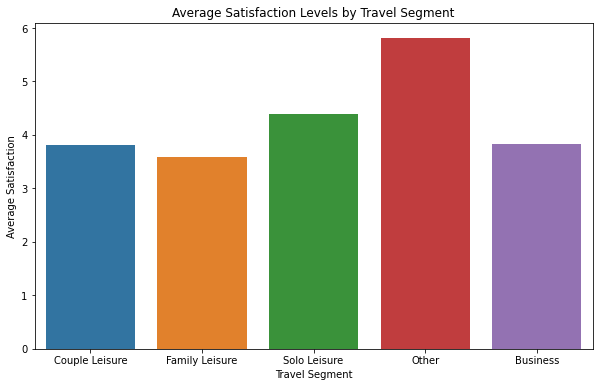

In [0]:
# Segment customers based on their type of travel

satisfaction_by_segment = air_df.groupBy("Type_Of_Traveller").agg(avg("Rating").alias("Average_Satisfaction"))

import matplotlib.pyplot as plt
import seaborn as sns

# Convert PySpark DataFrame to Pandas DataFrame for visualization
satisfaction_pd = satisfaction_by_segment.toPandas()

# Plot the satisfaction levels
plt.figure(figsize=(10, 6))
sns.barplot(x="Type_Of_Traveller", y="Average_Satisfaction", data=satisfaction_pd)
plt.title("Average Satisfaction Levels by Travel Segment")
plt.xlabel("Travel Segment")
plt.ylabel("Average Satisfaction")
plt.show()


## Words count process using Tokenizer and Stopwordremover

In [0]:
from pyspark.sql.functions import *
from pyspark.ml.feature import Tokenizer,StopWordsRemover
from pyspark.ml import Pipeline

In [0]:
text_data=air_df.select(lower(col("Review")).alias("Review"))
text_data.display()

Review
"not verified | totally unexceptional experience on our return journeys. on time flights, slow check-in especially in geneva. boarding was fairly slow. seating was satisfactory. flight attendants & trolley service were fine. baggage delivery was punctual & all arrived safely"
"? trip verified | disgusting service from start to finish, treated like an a piece of garbage at the gate for their mistake of not printing priority boarding on my boarding pass. and then told it was not their fault. well, then whose is it? also purchased heathrow express tickets through them and never received them, they blamed it on heathrow express and i was told to ring them. i will never fly this airline again, complete buffoonery and third rate service since pandemic. you lost a long time customer today."
? trip verified | disgraceful experience in munich. only one person at the desk and there was a huge line people waiting to check in bags. and at the last half and hour another person came and we went to her and done everything but there were queues at security and if that wasn’t enough the boarding pass didn’t scan at security so i had to wait to get my boarding pass back. but onboard it was a great experience. cabin crew were very friendly. and even during turbulence the pilot was talking on the intercom to say it’s fine. and on lufthansa that i just flew water was free on lufthansa but on aer lingus you had to pay three euro and they are not supposed to be a budget airline but one thing that was great at the airport was that they waited for everyone.
"? trip verified | flew on ei-eil, an old aircraft that is in horrific condition. seats broken, inflight entertainment broken, no wi-fi, no charging facilities. aircraft shouldn’t be in operation."
"? trip verified | my girlfriend and i had a 9 hours flight without tv and wifi. the food on board was ok with the meal they served but after the meal you can order only crisps, for 9 hours. insane that they pretend you should have only a meal and crisps, if you want a sandwich you can get after 6 hours. the cabin crew was ok, on board nothing works. looks like aer lingus doesn't care about clients."
"not verified | the check-in staff at manchester gave me incorrect information regarding my baggage. i was told it had been checked-in to phoenix but that it was necessary for me to retrieve it in chicago and place it on another conveyor belt. this was not true. my baggage went directly to phoenix, but it caused me a lot of unnecessary anxiety. having said that, the cabin crew exceeded all expectations. they were the friendliest, kindest and most helpful cabin crew i have ever flown with. this makes a huge difference. thank you aer lingus."
"? trip verified | aer lingus is the worst airline i have flown on. they cancelled a flight to manchester at midnight and abandoned more than 140 passengers at barbados airport with no help to find transport or hotel rooms. there were no aer lingus staff on the ground and the flight crew and captain vanished and went to a nearby hotel. the same thing happened the following night when the second flight was cancelled at 10pm. the passengers were treated with contempt. since then it has been impossible to get any help. the overseas contact centre is diabolical. they say they are unable to handle complaints and can't contact anyone senior at aer lingus or even the customer relations team because they ""have no phone numbers for them,"" this airline gives a bad name to the whole industry and is a disgrace to ireland as a country."
"? trip verified | bhx-bhd-bhx (7 oct - 9 oct) check-in counter at birmingham airport was quite friendly and jolly and appeared happy to speak to customers. my luggage including my friend’s were lumped into one since i had a 23kg baggage allowance. flying back from belfast to birmingham on ei3646 on the 9th of october, however was the complete opposite. this review is not entirely about the baggage but the appalling attitude of the woman behin

In [0]:
tokenizer=Tokenizer(inputCol='Review',outputCol='words')
stopwords=StopWordsRemover(inputCol="words",outputCol="filter_word")
pipeline=Pipeline(stages=[tokenizer,stopwords])
tokenized_data=pipeline.fit(text_data).transform(text_data)
tokenized_data.display()

Review,words,filter_word
"not verified | totally unexceptional experience on our return journeys. on time flights, slow check-in especially in geneva. boarding was fairly slow. seating was satisfactory. flight attendants & trolley service were fine. baggage delivery was punctual & all arrived safely","List(not, verified, |, , totally, unexceptional, experience, on, our, return, journeys., on, time, flights,, slow, check-in, especially, in, geneva., boarding, was, fairly, slow., seating, was, satisfactory., flight, attendants, &, trolley, service, were, fine., baggage, delivery, was, punctual, &, all, arrived, safely)","List(verified, |, , totally, unexceptional, experience, return, journeys., time, flights,, slow, check-in, especially, geneva., boarding, fairly, slow., seating, satisfactory., flight, attendants, &, trolley, service, fine., baggage, delivery, punctual, &, arrived, safely)"
"? trip verified | disgusting service from start to finish, treated like an a piece of garbage at the gate for their mistake of not printing priority boarding on my boarding pass. and then told it was not their fault. well, then whose is it? also purchased heathrow express tickets through them and never received them, they blamed it on heathrow express and i was told to ring them. i will never fly this airline again, complete buffoonery and third rate service since pandemic. you lost a long time customer today.","List(?, trip, verified, |, , disgusting, service, from, start, to, finish,, treated, like, an, a, piece, of, garbage, at, the, gate, for, their, mistake, of, not, printing, priority, boarding, on, my, boarding, pass., and, then, told, it, was, not, their, fault., well,, then, whose, is, it?, also, purchased, heathrow, express, tickets, through, them, and, never, received, them,, they, blamed, it, on, heathrow, express, and, i, was, told, to, ring, them., i, will, never, fly, this, airline, again,, complete, buffoonery, and, third, rate, service, since, pandemic., you, lost, a, long, time, customer, today.)","List(?, trip, verified, |, , disgusting, service, start, finish,, treated, like, piece, garbage, gate, mistake, printing, priority, boarding, boarding, pass., told, fault., well,, whose, it?, also, purchased, heathrow, express, tickets, never, received, them,, blamed, heathrow, express, told, ring, them., never, fly, airline, again,, complete, buffoonery, third, rate, service, since, pandemic., lost, long, time, customer, today.)"
? trip verified | disgraceful experience in munich. only one person at the desk and there was a huge line people waiting to check in bags. and at the last half and hour another person came and we went to her and done everything but there were queues at security and if that wasn’t enough the boarding pass didn’t scan at security so i had to wait to get my boarding pass back. but onboard it was a great experience. cabin crew were very friendly. and even during turbulence the pilot was talking on the intercom to say it’s fine. and on lufthansa that i just flew water was free on lufthansa but on aer lingus you had to pay three euro and they are not supposed to be a budget airline but one thing that was great at the airport was that they waited for everyone.,"List(?, trip, verified, |, disgraceful, experience, in, munich., only, one, person, at, the, desk, and, there, was, a, huge, line, people, waiting, to, check, in, bags., and, at, the, last, half, and, hour, another, person, came, and, we, went, to, her, and, done, everything, but, there, were, queues, at, security, and, if, that, wasn’t, enough, the, boarding, pass, didn’t, scan, at, security, so, i, had, to, wait, to, get, my, boarding, pass, back., but, onboard, it, was, a, great, experience., cabin, crew, were, very, friendly., and, even, during, turbulence, the, pilot, was, talking, on, the, intercom, to, say, it’s, fine., and, on, lufthansa, that, i, just, flew, water, was, free, on, lufthansa, but, on, aer, lingus, you, had, to, pay, three, euro, 

In [0]:
exp_data=tokenized_data.select(explode(col("filter_word")).alias("explod_words"))
# exp_data.count()

In [0]:
word_count=exp_data.groupBy('explod_words').count()
# word_count.display()
filter_word_count=word_count.filter(col("explod_words").isin(['delay','delayed','late','cancled','unprofessional']))
filter_word_count.display()

explod_words,count
delay,4115
late,4525
delayed,9556
unprofessional,543
cancled,1


## Perform Sentiment Analysis:
* Tokenize the text, clean it, and use VADER for sentiment analysis.

In [0]:
!pip install pyspark nltk

     |▍  

*** WARNING: max output size exceeded, skipping output. ***

     |████████████████████████████████| 317.0 MB 11 kB/s 
     |████████████████████████████████| 1.5 MB 46.5 MB/s 
     |████████████████████████████████| 200 kB 48.5 MB/s 
     |████████████████████████████████| 78 kB 9.4 MB/s 
     |████████████████████████████████| 773 kB 41.7 MB/s 
  Created wheel for pyspark: filename=pyspark-3.5.1-py2.py3-none-any.whl size=317488511 sha256=9efa33e955c2a85dd4931a9e19d8af88cee28bc173a35a3008b518f3ab7c9bb0
  Stored in directory: /root/.cache/pip/wheels/92/09/11/aa01d01a7f005fda8a66ad71d2be7f8aa341bddafb27eee3c7
Successfully built pyspark
You should consider upgrading via the '/local_disk0/.ephemeral_nfs/envs/pythonEnv-f92cad7e-7c63-462f-8e7c-fa432e9296d3/bin/python -m pip install --upgrade pip' command.


In [0]:
import nltk
from nltk.sentiment import SentimentIntensityAnalyzer
from pyspark.sql.functions import udf
from pyspark.sql.types import DoubleType
# Download NLTK VADER lexicon
nltk.download('vader_lexicon')

# Initialize the Sentiment Intensity Analyzer
sia = SentimentIntensityAnalyzer()

# Define a UDF for sentiment analysis
def analyze_sentiment(text):
    return sia.polarity_scores(text)["compound"]

# Apply the sentiment analysis UDF to the 'Review' column
sentiment_analysis_udf = udf(analyze_sentiment, DoubleType())
air_df = air_df.withColumn("Sentiment_Score", round(sentiment_analysis_udf(col("Review")),2))


[nltk_data] Downloading package vader_lexicon to /root/nltk_data...


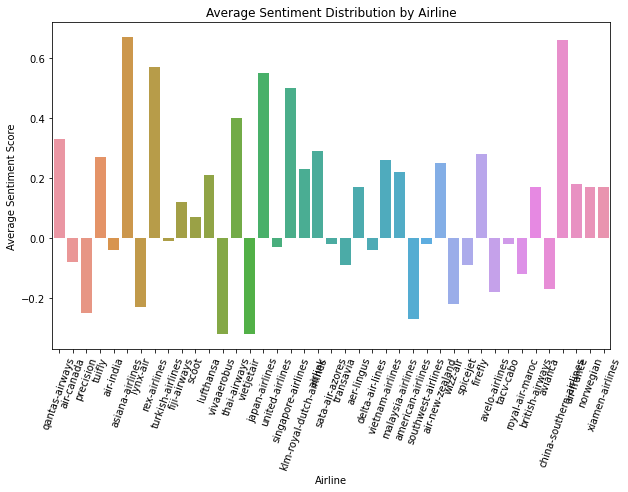

In [0]:
sentiment_distribution = air_df.groupBy("Airline_Name").agg(round(avg("Sentiment_Score"),2).alias("Average_Sentiment"))
# Convert PySpark DataFrame to Pandas DataFrame for visualization
sentiment_distribution_pd = sentiment_distribution.toPandas()

import matplotlib.pyplot as plt
import seaborn as sns
# Plot the sentiment distribution
plt.figure(figsize=(10, 6))
sns.barplot(x="Airline_Name", y="Average_Sentiment", data=sentiment_distribution_pd)
plt.title("Average Sentiment Distribution by Airline")
plt.xlabel("Airline")
plt.ylabel("Average Sentiment Score")
plt.xticks(rotation=70)
plt.show()

In [0]:
# Assuming 'Airline_Name' is the column containing airline names (British Airways and its competitors).
ba_and_competitors_df = air_df.filter(col("Airline_Name").isin(['british-airways','air-india','air-canada','air-france','american-airlines']))

performance_comparison = ba_and_competitors_df.groupBy("Airline_Name").agg(
    round(avg("Seat_Comfort"),2).alias("Average_Seat_Comfort"),
    round(avg("Cabin_Staff_Service"),2).alias("Average_Cabin_Staff_Service"),
    round(avg("Ground_Service"),2).alias("Average_Ground_Service")
)
performance_comparison.display()

Airline_Name,Average_Seat_Comfort,Average_Cabin_Staff_Service,Average_Ground_Service
air-canada,2.54,2.73,2.08
air-india,2.82,2.79,2.26
american-airlines,2.05,2.22,1.66
british-airways,2.87,3.25,2.64
air-france,2.95,3.33,2.54


# Calculate Correlation Matrix:
* Calculate the correlation matrix to explore the relationships between different aspects.

In [0]:
pd_df=air_df.toPandas()
# print(pd_df)

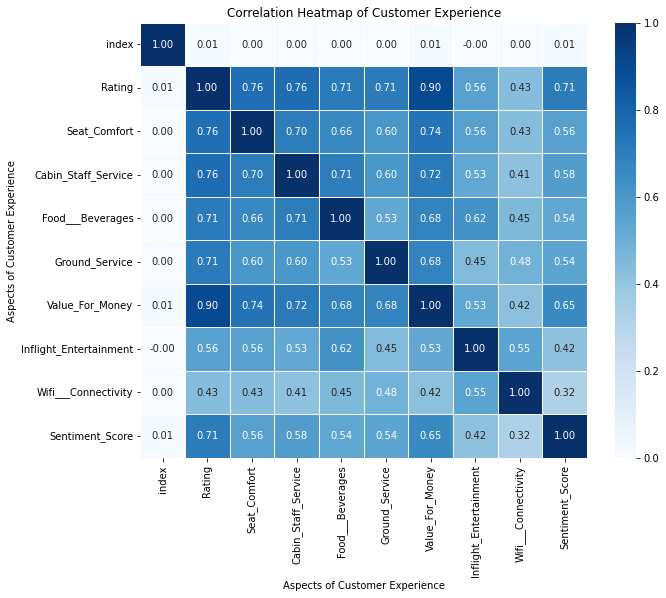

In [0]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming pd_df is your Pandas DataFrame
correlation_matrix = pd_df.corr()

# Create a heatmap with additional details
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap="Blues", linewidths=.5, fmt=".2f")

# Add axis labels and title
plt.xlabel("Aspects of Customer Experience")
plt.ylabel("Aspects of Customer Experience")
plt.title("Correlation Heatmap of Customer Experience")

# Display the plot
plt.show()
